# Store Sales Time Series Forecasting Data Wrangling and EDA

## Data Wrangling

In [1]:
#import base packages
import pandas as pd
import numpy as np
import os
import gc
import warnings

#PACF-ACF
import statsmodels.api as sm

#data visualization
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px

In [17]:
#import data
train = pd.read_csv('raw_data/train.csv')
test= pd.read_csv('raw_data/test.csv')
stores= pd.read_csv('raw_data/stores.csv')
transactions = pd.read_csv('raw_data/transactions.csv')

train.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0


In [19]:
#datetime
train['date']= pd.to_datetime(train.date)
test['date']= pd.to_datetime(test.date)
transactions['date']= pd.to_datetime(transactions.date)

train.head()

,id,date,store_nbr,family,sales,onpromotion
0,0,2013-01-01,1,AUTOMOTIVE,0.0,0
1,1,2013-01-01,1,BABY CARE,0.0,0
2,2,2013-01-01,1,BEAUTY,0.0,0
3,3,2013-01-01,1,BEVERAGES,0.0,0
4,4,2013-01-01,1,BOOKS,0.0,0


In [27]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3000888 entries, 0 to 3000887
Data columns (total 6 columns):
 #   Column       Dtype         
---  ------       -----         
 0   id           int64         
 1   date         datetime64[ns]
 2   store_nbr    int64         
 3   family       object        
 4   sales        float64       
 5   onpromotion  int64         
dtypes: datetime64[ns](1), float64(1), int64(3), object(1)
memory usage: 137.4+ MB


In [28]:
#data types
train.onpromotion= train.onpromotion.astype('float16')
train.sales=train.sales.astype('float32')
stores.cluster= stores.cluster.astype('int8')

### Check for Missing Data

In [29]:
missing = pd.concat([train.isnull().sum(), 100 * train.isnull().mean()], axis=1)
missing.columns=['count','%']
missing.sort_values(by='count', ascending = False)

,count,%
id,0,0.0
date,0,0.0
store_nbr,0,0.0
family,0,0.0
sales,0,0.0
onpromotion,0,0.0


In [34]:
missing = pd.concat([test.isnull().sum(), 100 * test.isnull().mean()], axis=1)
missing.columns=['count','%']
missing.sort_values(by='count', ascending = False)

,count,%
id,0,0.0
date,0,0.0
store_nbr,0,0.0
family,0,0.0
onpromotion,0,0.0


In [32]:
missing = pd.concat([transactions.isnull().sum(), 100 * transactions.isnull().mean()], axis=1)
missing.columns=['count','%']
missing.sort_values(by='count', ascending = False)

,count,%
date,0,0.0
store_nbr,0,0.0
transactions,0,0.0


In [33]:
missing = pd.concat([stores.isnull().sum(), 100 * stores.isnull().mean()], axis=1)
missing.columns=['count','%']
missing.sort_values(by='count', ascending = False)

,count,%
store_nbr,0,0.0
city,0,0.0
state,0,0.0
type,0,0.0
cluster,0,0.0


No missing data. Can move onto EDA

## EDA

## Transactions

In [35]:
transactions.head()

,date,store_nbr,transactions
0,2013-01-01,25,770
1,2013-01-02,1,2111
2,2013-01-02,2,2358
3,2013-01-02,3,3487
4,2013-01-02,4,1922


In [36]:
transactions.sort_values(['store_nbr', 'date'])

,date,store_nbr,transactions
1,2013-01-02,1,2111
47,2013-01-03,1,1833
93,2013-01-04,1,1863
139,2013-01-05,1,1509
185,2013-01-06,1,520
...,...,...,...
83271,2017-08-11,54,768
83325,2017-08-12,54,903
83379,2017-08-13,54,1054
83433,2017-08-14,54,818


In [37]:
#Spearman Correlation between Total Sales and Transactions

temp = pd.merge(train.groupby(["date", "store_nbr"]).sales.sum().reset_index(), transactions, how = "left")
print("Spearman Correlation between Total Sales and Transactions: {:,.4f}".format(temp.corr("spearman").sales.loc["transactions"]))
px.line(transactions.sort_values(["store_nbr", "date"]), x='date', y='transactions', color='store_nbr',title = "Transactions" )

Spearman Correlation between Total Sales and Transactions: 0.8175


Transactions means how many people came to the store or how many invoices were created in a day. Sales gives the total sales for a product family at a particular store on a given date. Transactions and sales have a high correlation: 0.8175. Store sales have a tendency to increase at the end of December. May need to increase inventory around this time.

In [108]:
#boxplot
#a = transactions.copy()
#a["year"] = a.date.dt.year
#a["month"] = a.date.dt.month
#px.box(a, x="year", y="transactions" , color = "month", title = "Transactions")

Can see a stable transactions pattern. From 2013-2017, most of the months are similar, except there is a huge spike in December. July usually has the least amount of transactions.

In [39]:
#monthly average transactions
a = transactions.set_index("date").resample("M").transactions.mean().reset_index()
a["year"] = a.date.dt.year
px.line(a, x='date', y='transactions', color='year',title = "Monthly Average Transactions" )

Sales skyrocket towards the end of the year. Aside from the end of the year, sales seem to increase then peak around March-May and then decreases before the spike in December.

In [107]:
#total sales and transactions

#px.scatter(temp, x = "transactions", y = "sales", trendline = "ols", trendline_color_override = "red")

In [45]:
## Transaction by day of week 
a = transactions.copy()
a["year"] = a.date.dt.year
a["dayofweek"] = a.date.dt.dayofweek+1
a = a.groupby(["year", "dayofweek"]).transactions.mean().reset_index()
px.line(a, x="dayofweek", y="transactions" , color = "year", title = "Transactions")


Most transactions are done on Saturadays. Important to have enough inventory on days people shop the most. 

## Oil Prices

Ecuador is an oil dependent country. Changing oil prices in Ecuador will cause a variance in the model.

In [50]:
#import oil data
oil= pd.read_csv('raw_data/oil.csv')
oil['date']=pd.to_datetime(oil.date)
oil.head()

,date,dcoilwtico
0,2013-01-01,NaN
1,2013-01-02,93.14
2,2013-01-03,92.97
3,2013-01-04,93.12
4,2013-01-07,93.20


In [51]:
oil.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1218 entries, 0 to 1217
Data columns (total 2 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   date        1218 non-null   datetime64[ns]
 1   dcoilwtico  1175 non-null   float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 19.2 KB


In [53]:
missing = pd.concat([oil.isnull().sum(), 100 * oil.isnull().mean()], axis=1)
missing.columns=['count','%']
missing.sort_values(by='count', ascending = False)

,count,%
dcoilwtico,43,3.530378
date,0,0.000000


In [54]:
#linear interpolation to predict missing data for time series
# resample
oil = oil.set_index("date").dcoilwtico.resample("D").sum().reset_index()

#interpolate
oil["dcoilwtico"] = np.where(oil["dcoilwtico"] == 0, np.nan, oil["dcoilwtico"])
oil["dcoilwtico_interpolated"] =oil.dcoilwtico.interpolate()

#plot
p = oil.melt(id_vars=['date']+list(oil.keys()[5:]), var_name='Legend')
px.line(p.sort_values(["Legend", "date"], ascending = [False, True]), x='date', y='value', color='Legend',title = "Daily Oil Price" )


If daily oil price is high, we expect the economy to be doing poorly, causing product prices to increase and sales to decrease. Therfore, there should be a negative correlation between daily oily prices and sales. 

Correlation with Daily Oil Prices
sales          -0.303237
transactions    0.040105
Name: dcoilwtico_interpolated, dtype: float64 



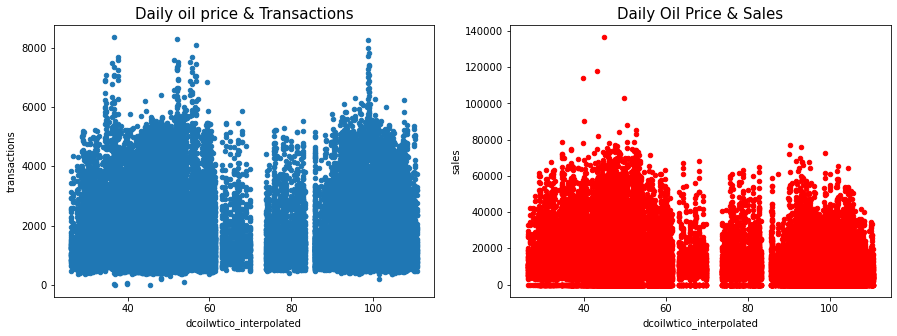

In [55]:
#temp = pd.merge(temp, oil, how = "left")
#print("Correlation with Daily Oil Prices")
#print(temp.drop(["store_nbr", "dcoilwtico"], axis = 1).corr("spearman").dcoilwtico_interpolated.loc[["sales", "transactions"]], "\n")


#fig, axes = plt.subplots(1, 2, figsize = (15,5))
#temp.plot.scatter(x = "dcoilwtico_interpolated", y = "transactions", ax=axes[0])
#temp.plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[1], color = "r")
#axes[0].set_title('Daily oil price & Transactions', fontsize = 15)
#axes[1].set_title('Daily Oil Price & Sales', fontsize = 15);

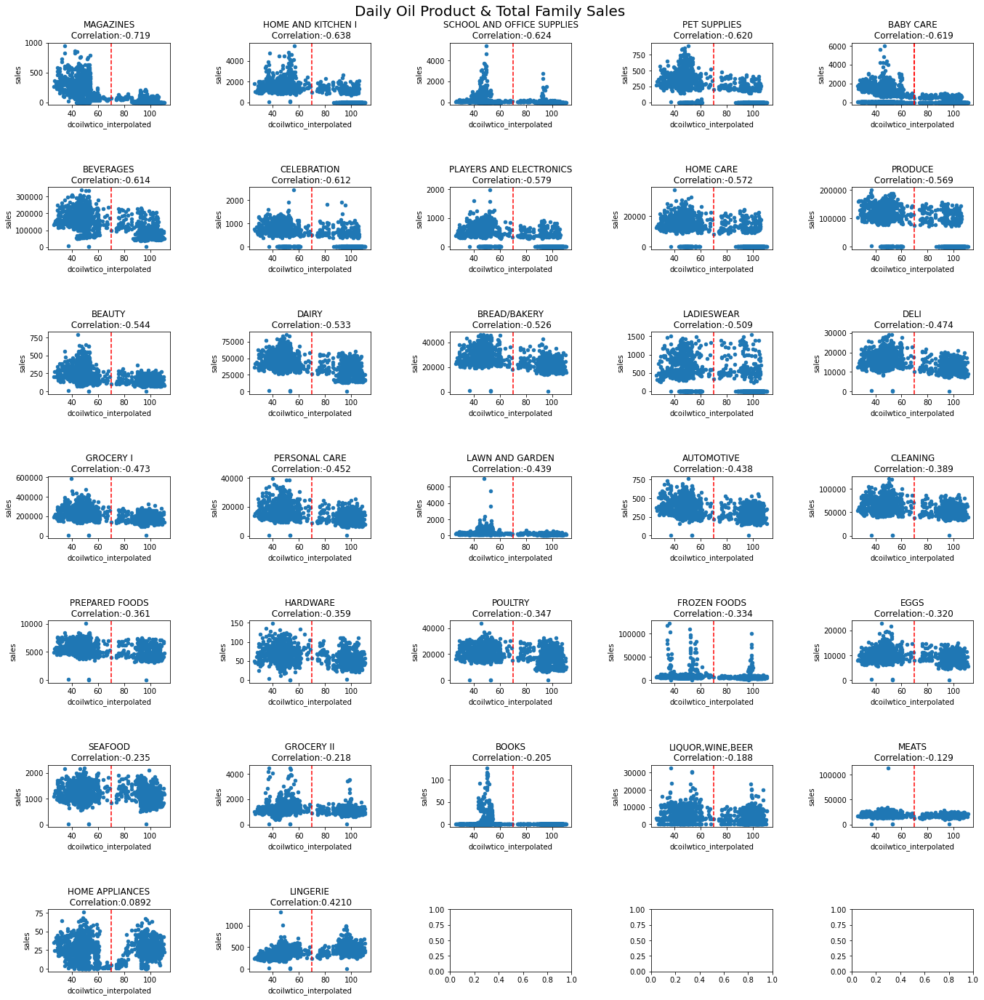

In [56]:
a = pd.merge(train.groupby(["date", "family"]).sales.sum().reset_index(), oil.drop("dcoilwtico", axis = 1), how = "left")
c = a.groupby("family").corr("spearman").reset_index()
c = c[c.level_1 == "dcoilwtico_interpolated"][["family", "sales"]].sort_values("sales")

fig, axes = plt.subplots(7, 5, figsize = (20,20))
for i, fam in enumerate(c.family):
    if i < 6:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[0, i-1])
        axes[0, i-1].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[0, i-1].axvline(x=70, color='r', linestyle='--')
    if i >= 6 and i<11:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[1, i-6])
        axes[1, i-6].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[1, i-6].axvline(x=70, color='r', linestyle='--')
    if i >= 11 and i<16:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[2, i-11])
        axes[2, i-11].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[2, i-11].axvline(x=70, color='r', linestyle='--')
    if i >= 16 and i<21:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[3, i-16])
        axes[3, i-16].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[3, i-16].axvline(x=70, color='r', linestyle='--')
    if i >= 21 and i<26:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[4, i-21])
        axes[4, i-21].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[4, i-21].axvline(x=70, color='r', linestyle='--')
    if i >= 26 and i < 31:
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[5, i-26])
        axes[5, i-26].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[5, i-26].axvline(x=70, color='r', linestyle='--')
    if i >= 31 :
        a[a.family == fam].plot.scatter(x = "dcoilwtico_interpolated", y = "sales", ax=axes[6, i-31])
        axes[6, i-31].set_title(fam+"\n Correlation:"+str(c[c.family == fam].sales.iloc[0])[:6], fontsize = 12)
        axes[6, i-31].axvline(x=70, color='r', linestyle='--')
        
        
plt.tight_layout(pad=5)
plt.suptitle("Daily Oil Product & Total Family Sales \n", fontsize = 20);
plt.show()

Scatter plot for various product families. All of the plots follow a similar pattern. There are two distinct clusters. When daily oil price is under 70, there are more sales. 

## Sales

In [105]:
#a = train[["store_nbr", "sales"]]
#a["ind"] = 1
#a["ind"] = a.groupby("store_nbr").ind.cumsum().values
#a = pd.pivot(a, index = "ind", columns = "store_nbr", values = "sales").corr()
#mask = np.triu(a.corr())
#plt.figure(figsize=(20, 20))
#sns.heatmap(a,
#        annot=True,
#        fmt='.1f',
#        cmap='coolwarm',
#        square=True,
#        mask=mask,
#        linewidths=1,
#        cbar=False)
#plt.title("Correlations among stores",fontsize = 20)
#plt.show()

In [58]:
#daily total sales of the stores
a = train.set_index("date").groupby("store_nbr").resample("D").sales.sum().reset_index()
px.line(a, x = "date", y= "sales", color = "store_nbr", title = "Daily total sales of the stores")

In [59]:
# Stores 20, 21, 22, 29, 36, 42, 52 and 53 have no sales at the beginning of 2013 before the stores opened.
#Get rid these rows

print(train.shape)
train = train[~((train.store_nbr == 52) & (train.date < "2017-04-20"))]
train = train[~((train.store_nbr == 22) & (train.date < "2015-10-09"))]
train = train[~((train.store_nbr == 42) & (train.date < "2015-08-21"))]
train = train[~((train.store_nbr == 21) & (train.date < "2015-07-24"))]
train = train[~((train.store_nbr == 29) & (train.date < "2015-03-20"))]
train = train[~((train.store_nbr == 20) & (train.date < "2015-02-13"))]
train = train[~((train.store_nbr == 53) & (train.date < "2014-05-29"))]
train = train[~((train.store_nbr == 36) & (train.date < "2013-05-09"))]
train.shape

(3000888, 6)


(2780316, 6)

### Zero Forecasting

Some stores do not carry certain product families

In [60]:
c = train.groupby(["store_nbr", "family"]).sales.sum().reset_index().sort_values(["family","store_nbr"])
c = c[c.sales == 0]
c

,store_nbr,family,sales
1,1,BABY CARE,0.0
397,13,BABY CARE,0.0
727,23,BABY CARE,0.0
1420,44,BABY CARE,0.0
1453,45,BABY CARE,0.0
1486,46,BABY CARE,0.0
1519,47,BABY CARE,0.0
1552,48,BABY CARE,0.0
1585,49,BABY CARE,0.0
1618,50,BABY CARE,0.0


In [61]:
#remove product familes with no sales 
print(train.shape)

# Anti Join
outer_join = train.merge(c[c.sales == 0].drop("sales",axis = 1), how = 'outer', indicator = True)
train = outer_join[~(outer_join._merge == 'both')].drop('_merge', axis = 1)
del outer_join
gc.collect()
train.shape

(2780316, 6)


(2698648, 6)

In [62]:
zero_prediction = []
for i in range(0,len(c)):
    zero_prediction.append(
        pd.DataFrame({
            "date":pd.date_range("2017-08-16", "2017-08-31").tolist(),
            "store_nbr":c.store_nbr.iloc[i],
            "family":c.family.iloc[i],
            "sales":0
        })
    )
zero_prediction = pd.concat(zero_prediction)
del c
gc.collect()
zero_prediction

,date,store_nbr,family,sales
0,2017-08-16,1,BABY CARE,0
1,2017-08-17,1,BABY CARE,0
2,2017-08-18,1,BABY CARE,0
3,2017-08-19,1,BABY CARE,0
4,2017-08-20,1,BABY CARE,0
...,...,...,...,...
11,2017-08-27,54,LAWN AND GARDEN,0
12,2017-08-28,54,LAWN AND GARDEN,0
13,2017-08-29,54,LAWN AND GARDEN,0
14,2017-08-30,54,LAWN AND GARDEN,0


### Active or Passive Product Families

Some products rarely sell in the stores. They are considered passive if they have no been bought in the last 2 months. Keep in mind that some products depend on seasonality, so even if it shows they have not been bought in the past 2 months they are not considered passive

In [110]:
#c = train.groupby(["family", "store_nbr"]).tail(60).groupby(["family", "store_nbr"]).sales.sum().reset_index()
#c[c.sales == 0]

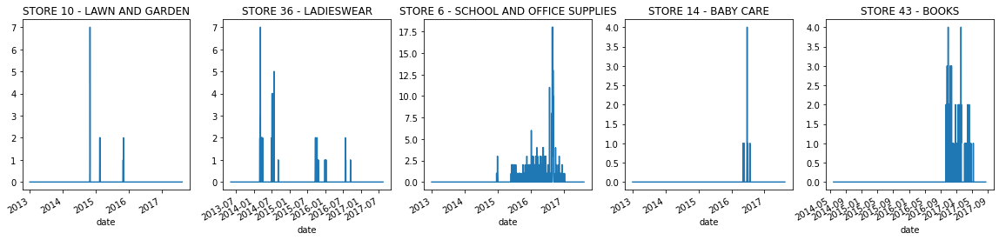

In [64]:
fig, ax = plt.subplots(1,5, figsize = (20,4))
train[(train.store_nbr == 10) & (train.family == "LAWN AND GARDEN")].set_index("date").sales.plot(ax = ax[0], title = "STORE 10 - LAWN AND GARDEN")
train[(train.store_nbr == 36) & (train.family == "LADIESWEAR")].set_index("date").sales.plot(ax = ax[1], title = "STORE 36 - LADIESWEAR")
train[(train.store_nbr == 6) & (train.family == "SCHOOL AND OFFICE SUPPLIES")].set_index("date").sales.plot(ax = ax[2], title = "STORE 6 - SCHOOL AND OFFICE SUPPLIES")
train[(train.store_nbr == 14) & (train.family == "BABY CARE")].set_index("date").sales.plot(ax = ax[3], title = "STORE 14 - BABY CARE")
train[(train.store_nbr == 53) & (train.family == "BOOKS")].set_index("date").sales.plot(ax = ax[4], title = "STORE 43 - BOOKS")
plt.show()

These product families have such low sales count. Not sure what to do with them yet. But can revisit if want to further improve model. 

In [111]:
#daily total sales of the product families
#a = train.set_index("date").groupby("family").resample("D").sales.sum().reset_index()
#px.line(a, x = "date", y= "sales", color = "family", title = "Daily total sales of the product families")

In [68]:
a = train.groupby("family").sales.mean().sort_values(ascending = False).reset_index()
px.bar(a, y = "family", x="sales", color = "family", title = "Which product family preferred more?")

GOOCERY I and BEVERAGES are the top selling families 

In [86]:
#Chart time series average sales on each day 

import plotly.graph_objs as go
train_aux = train[['date', 'sales', 'onpromotion']].groupby('date').mean()
train_aux = train_aux.reset_index()
fig = go.Figure(data=go.Scatter(x=train_aux['date'], 
                                y=train_aux['sales'],
                                marker_color='red', text="sales"))
fig.update_layout({"title": f'Avg Sales by date for all stores and products',
                   "xaxis": {"title":"Date"},
                   "yaxis": {"title":"Avg Unit Sold"},
                   "showlegend": False})
fig.show()

Sales show an increasing trend. Zooming in, can see that there is seasonality every 7 days. Highest sales are during the weekends. Note that 1st of January every year the supermarkets are not open, so sales are zero.

In [87]:
#on promotion vs avg sales chart

fig = px.scatter(train_aux[train_aux['onpromotion'] > 0], x="onpromotion", y="sales", color='sales', 
                           color_continuous_scale="earth",
                 size='sales', log_x=True, size_max=30)

fig.update_layout({"title": f'Correlation between OnPromotion and Sales (total avg sales and promotion on each day)',
                   "xaxis": {"title":"On Promotion"},
                   "yaxis": {"title":"Sales"},
                   "showlegend": False})
fig.show()


There is a positive correlation between on promotion and sales units sold. When items are on promotion, there are higher sales of the product.

### Holidays and Events

In [80]:
holidays = pd.read_csv('raw_data/holidays_events.csv')
holidays["date"] = pd.to_datetime(holidays.date)
holidays.head()

,date,type,locale,locale_name,description,transferred
0,2012-03-02,Holiday,Local,Manta,Fundacion de Manta,False
1,2012-04-01,Holiday,Regional,Cotopaxi,Provincializacion de Cotopaxi,False
2,2012-04-12,Holiday,Local,Cuenca,Fundacion de Cuenca,False
3,2012-04-14,Holiday,Local,Libertad,Cantonizacion de Libertad,False
4,2012-04-21,Holiday,Local,Riobamba,Cantonizacion de Riobamba,False


In [89]:
#filter holidays for the training dataset
holidays = holidays[(holidays['date'] >= "2013-01-01") & (holidays['date'] <= "2017-08-15")]

holidays.head()

,date,type,locale,locale_name,description,transferred
41,2013-01-01,Holiday,National,Ecuador,Primer dia del ano,False
42,2013-01-05,Work Day,National,Ecuador,Recupero puente Navidad,False
43,2013-01-12,Work Day,National,Ecuador,Recupero puente primer dia del ano,False
44,2013-02-11,Holiday,National,Ecuador,Carnaval,False
45,2013-02-12,Holiday,National,Ecuador,Carnaval,False


In [91]:
#average sales chart with events

##Let's look at the sales behavior for the whole data
train_aux = train[['date', 'sales']].groupby('date').mean()
train_aux = train_aux.reset_index()
fig = go.Figure(data=go.Scatter(x=train_aux['date'], 
                                y=train_aux['sales'],
                                marker_color='red', text="sales"))
for holiday_date in list(holidays['date']):
    fig.add_vline(x=holiday_date, line_width=0.5, line_dash="dash", line_color="green")
#fig.add_vline(x="2013-08-08", line_width=0.5, line_dash="dash", line_color="green", annotation="test")


fig.update_layout({"title": f'Avg Sales by date with Holidays and Events',
                   "xaxis": {"title":"Date"},
                   "yaxis": {"title":"Avg Unit Sold"},
                   "showlegend": False})
fig.show()

The earthquake hit 16th April 2016. One month onwards from that date we can see a slight increase in sales. After the earthquake there were more days off than usual.

In [95]:
fig = px.scatter(df_plot, x="date", y="sales", size='sales', color='type')
                 #size='sales', color='sales',
                  #color_continuous_scale="pinkyl")

fig.update_layout({"title": f'Avg Sales on Holiday Events days',
                   "xaxis": {"title":"HOLIDAY EVENT DATE"},
                   "yaxis": {"title":"Avg Sales"},
                   "showlegend": True})

fig.add_annotation(x='2014-07-05',y=500,xref="x",yref="y",text="WORLD CUP",showarrow=True, align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=-30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#ca8ee8",opacity=0.8  )

fig.add_annotation(x='2016-04-20',y=800,xref="x",yref="y",text="EARTHQUAKE",showarrow=True,align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=-30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#ca8ee8",opacity=0.8)

fig.add_annotation(x='2013-12-30',y=200,xref="x",yref="y",text="CHRISTAMS 13/14",showarrow=True,align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#3ce685",opacity=0.8)


fig.add_annotation(x='2014-12-30',y=200,xref="x",yref="y",text="CHRISTAMS 14/15",showarrow=True,align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#3ce685",opacity=0.8)


fig.add_annotation(x='2015-12-30',y=200,xref="x",yref="y",text="CHRISTAMS 15/16",showarrow=True,align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#3ce685",opacity=0.8)


fig.add_annotation(x='2016-12-30',y=200,xref="x",yref="y",text="CHRISTAMS 16/17",showarrow=True,align="center",arrowhead=2,arrowsize=1,
        arrowwidth=2,arrowcolor="#636363",ax=0,ay=30,bordercolor="#c7c7c7",borderwidth=2,borderpad=4,bgcolor="#3ce685",opacity=0.8)



fig.show()

Confirms the average increasing trend in sales. We can clearly see two zones with purple bubbles on consecutive days. If we check the description column, we can clearly see that the purple bubbles of June 2014 correspond to the Football World Cup of Brazil and the purple bubbles of Apr 2016 correspond o days off given by the goverment due to the earthquake. During these two events, teh sales went up.
The majority of light green bubles at the end of every year correspond to Christmas celebrations (in December). During this time, people gather togeteher and spend money on quality food and presents for Christmas gatherings with family and friends. We can see that on these days he avg amount spent is he highest for each year.
Black Friday and Cyber Monday (light blue) are also considered. From the chart we can realize that in 2013 and 2014 Black Friday didn't exist in Ecuador. Regarding the avg sales, we can see that they are not as high as expected if we compare them with Christmas sales. It might be because the supermarkets are brick and mortar stores, not e-commerce sites.

### Analysis of Salaries
Wages in the public sector are paid every two weeks on the 15 th and on the last day of the month. Let´s study if supermarket sales are affected by this.

In [96]:
#create a list with the dates of when salaries are paid. 
#start_date = '2013-01-01'
#end_date = '2017-08-15'
#salary_dates = pd.date_range(start=start_date , end=end_date , freq='SM').tolist()
#salary_dates = [pd.to_datetime(date.to_datetime64()).strftime('%Y-%m-%d') for date in salary_dates]
#print(len(salary_dates))

111


In [106]:
##Let's look at the sales behavior for the whole data
#train_aux = train[['date', 'sales']].groupby('date').mean()
#train_aux = train_aux.reset_index()
#fig = go.Figure(data=go.Scatter(x=train_aux['date'], 
#                                y=train_aux['sales'],
#                                marker_color='brown', text="sales"))
#for salary_date in salary_dates:
#    fig.add_vline(x=salary_date, line_width=0.5, line_dash="dash", line_color="blue")


#fig.update_layout({"title": f'Avg Sales by date with Holidays Events',
#                   "xaxis": {"title":"Date"},
#                   "yaxis": {"title":"Avg Unit Sold"},
#                   "showlegend": False})
#fig.show()

In [109]:
#save data

#train.to_csv(r'C:\Users\Myngoc\Desktop\Data Science\Capstone Three\cleaned_data\train.csv', index=False)
#transactions.to_csv(r'C:\Users\Myngoc\Desktop\Data Science\Capstone Three\cleaned_data\transaction.csv', index=False)
#oil.to_csv(r'C:\Users\Myngoc\Desktop\Data Science\Capstone Three\cleaned_data\oil.csv', index=False)
#stores.to_csv(r'C:\Users\Myngoc\Desktop\Data Science\Capstone Three\cleaned_data\stores.csv', index=False)
#holidays.to_csv(r'C:\Users\Myngoc\Desktop\Data Science\Capstone Three\cleaned_data\holidays_events.csv', index=False)